In [163]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [168]:
import sys

sys.path.append("../")

import cv2
import numpy as np
from tqdm import tqdm
from pathlib import Path
from justpfm import justpfm
from scipy.stats import norm
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from scipy.optimize import curve_fit

from src.utils.saliency import get_kde_density, get_saliency_map
from src.config import DEPTH_MAP_PFM_PATH, SALIENCY_MAP_PFM_PATH

N_BINS = 100

In [165]:
def show_saliency_depth_map(
    experiment_id: int, session_id: int, sequence_id: int
) -> None:
    if experiment_id == 1:
        session_str = "images" if session_id == 1 else "videos"
    else:
        session_str = "clear" if session_id == 1 else "overcast"

    depth_file_path = f"{DEPTH_MAP_PFM_PATH}/experiment{experiment_id}/{session_str}/scene{sequence_id}.pfm"
    saliency_file_path = f"{SALIENCY_MAP_PFM_PATH}/experiment{experiment_id}/{session_str}/scene{sequence_id}.pfm"

    # Load maps
    depth_map = justpfm.read_pfm(file_name=depth_file_path)
    saliency_map = justpfm.read_pfm(file_name=saliency_file_path)

    # Resize the saliency map to the size of the depth map
    saliency_map = cv2.resize(saliency_map, (depth_map.shape[1], depth_map.shape[0]))

    # Show maps on top of each other
    plt.figure(figsize=(25, 6))
    plt.imshow(depth_map, cmap="gray")
    plt.colorbar(label="Depth map")
    contours = plt.contour(saliency_map, levels=10, cmap="jet")
    plt.colorbar(contours, label="Saliency map")
    plt.title(
        f"Depth map and saliency map for experiment {experiment_id} session {session_id} sequence {sequence_id}"
    )
    plt.tight_layout()
    plt.show()

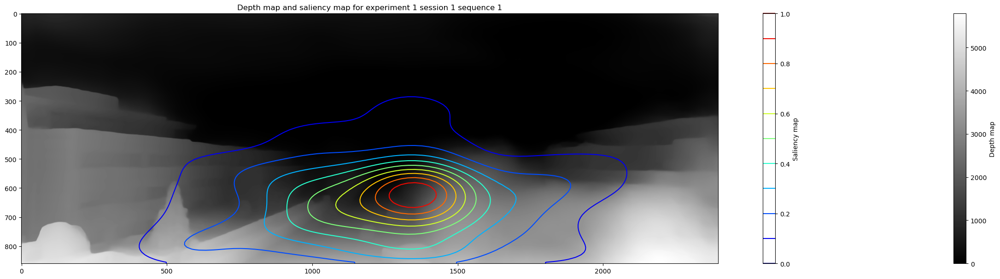

In [9]:
show_saliency_depth_map(experiment_id=1, session_id=1, sequence_id=1)

In [166]:
def show_all_saliency_depth_maps(
    n_cols: int,
):
    # Get files and sort by name as they are named in the same format
    depth_file_paths = Path(DEPTH_MAP_PFM_PATH).rglob("*.pfm")
    depth_file_paths = sorted(depth_file_paths)
    saliency_file_paths = Path(SALIENCY_MAP_PFM_PATH).rglob("*.pfm")
    saliency_file_paths = sorted(saliency_file_paths)

    n_total = len(depth_file_paths)
    n_rows = n_total // n_cols + 1

    plt.figure(figsize=(100, 80))
    for i, (depth_file_path, saliency_file_path) in tqdm(
        enumerate(zip(depth_file_paths, saliency_file_paths)), desc="⌛ Loading maps..."
    ):
        # Load maps
        depth_map = justpfm.read_pfm(file_name=depth_file_path)
        saliency_map = justpfm.read_pfm(file_name=saliency_file_path)

        # Resize the saliency map to the size of the depth map
        saliency_map = cv2.resize(
            saliency_map, (depth_map.shape[1], depth_map.shape[0])
        )

        # Show maps on top of each other
        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(depth_map, cmap="gray", label="Depth map")
        plt.contour(saliency_map, levels=10, cmap="jet", label="Saliency map")
        plt.axis("off")
    plt.tight_layout()
    plt.show()

In [94]:
show_all_saliency_depth_maps(n_cols=5)

⌛ Loading maps...: 50it [00:09,  5.47it/s]


In [167]:
def get_saliency_depth_features() -> np.ndarray:
    """
    Load all depth and saliency maps and return them as a 2D array

    Returns:
        np.ndarray: 2D array of depth and saliency maps
    """
    depth_file_paths = Path(DEPTH_MAP_PFM_PATH).rglob("*.pfm")
    depth_file_paths = sorted(depth_file_paths)
    saliency_file_paths = Path(SALIENCY_MAP_PFM_PATH).rglob("*.pfm")
    saliency_file_paths = sorted(saliency_file_paths)

    X = []
    for depth_file_path, saliency_file_path in tqdm(
        zip(depth_file_paths, saliency_file_paths), desc="⌛ Loading maps..."
    ):
        # Load maps
        depth_map = justpfm.read_pfm(file_name=depth_file_path)
        saliency_map = justpfm.read_pfm(file_name=saliency_file_path)

        # Normalize the depth map
        depth_map = cv2.normalize(depth_map, None, 0, 1, cv2.NORM_MINMAX, cv2.CV_32F)
        # Invert the depth map as lower values are initially further away
        depth_map = 1 - depth_map

        # Resize the saliency map to the size of the depth map
        saliency_map = cv2.resize(
            saliency_map, (depth_map.shape[1], depth_map.shape[0])
        )

        # Merge the maps
        maps = np.dstack((depth_map, saliency_map))
        flat_maps = maps.reshape(-1, 2)

        # Append to the dataset
        X = np.vstack((X, flat_maps)) if len(X) else flat_maps

    return X


def get_center_bias_depth_features(center_bias_distribution: np.ndarray) -> np.ndarray:
    depth_file_paths = Path(DEPTH_MAP_PFM_PATH).rglob("*.pfm")
    depth_file_paths = sorted(depth_file_paths)

    X = []
    for i, depth_file_path in tqdm(
        enumerate(depth_file_paths), desc="⌛ Loading maps..."
    ):
        # Load maps
        depth_map = justpfm.read_pfm(file_name=depth_file_path)
        saliency_map = center_bias_distribution.copy()

        # Normalize the depth map
        depth_map = cv2.normalize(depth_map, None, 0, 1, cv2.NORM_MINMAX, cv2.CV_32F)
        depth_map = (
            1 - depth_map
        )  # Invert the depth map as lower values are initially further away

        # Resize the saliency map to the size of the depth map
        saliency_map = cv2.resize(
            saliency_map, (depth_map.shape[1], depth_map.shape[0])
        )

        # Merge the maps
        maps = np.dstack((depth_map, saliency_map))
        flat_maps = maps.reshape(-1, 2)

        # Append to the dataset
        X = np.vstack((X, flat_maps)) if len(X) else flat_maps

    return X


def gaussian_2d(
    x: np.ndarray,
    y: np.ndarray,
    x0: float,
    y0: float,
    sigma_x: float,
    sigma_y: float,
    A: float,
) -> np.ndarray:
    """
    A 2D Gaussian function

    Args:
        x (np.ndarray): x values
        y (np.ndarray): y values
        x0 (float): x center
        y0 (float): y center
        sigma_x (float): x standard deviation
        sigma_y (float): y standard deviation
        A (float): amplitude
    """

    return A * np.exp(
        -((x - x0) ** 2 / (2 * sigma_x**2) + (y - y0) ** 2 / (2 * sigma_y**2))
    )


def fit_gaussian(
    data: np.ndarray,
    width: int,
    height: int,
) -> np.ndarray:
    """
    Fit a 2D Gaussian to the given data

    Args:
        data (np.ndarray): 2D data to fit
        width (int): width of the data
        height (int): height of the data

    Returns:
        np.ndarray: fitted Gaussian
    """
    # Create a 2D grid
    x, y = np.meshgrid(np.arange(width), np.arange(height))

    # Flatten the arrays to fit with curve_fit
    x_data = np.vstack((x.ravel(), y.ravel()))
    z_data = data.ravel()

    # Start with an initial guess for (x0, y0, sigma_x, sigma_y, A)
    initial_guess = (width // 2, height // 2, 20, 30, 1)

    # Fit the Gaussian model to the data
    popt, _ = curve_fit(
        lambda xdata, x0, y0, sigma_x, sigma_y, A: gaussian_2d(
            xdata[0], xdata[1], x0, y0, sigma_x, sigma_y, A
        ),
        x_data,
        z_data,
        p0=initial_guess,
    )

    # Get the optimized parameters
    x0, y0, sigma_x, sigma_y, A = popt
    print(
        f"Optimized parameters: x0={x0}, y0={y0}, sigma_x={sigma_x}, sigma_y={sigma_y}, A={A}"
    )

    # Generate the fitted Gaussian using the optimized parameters
    fitted_gaussian = gaussian_2d(x, y, x0, y0, sigma_x, sigma_y, A)

    return fitted_gaussian


def get_global_saliency_map() -> np.ndarray:
    """
    Get the global saliency map by merging all saliency maps

    Returns:
        np.ndarray: global saliency map
    """
    saliency_file_paths = Path(SALIENCY_MAP_PFM_PATH).rglob("*.pfm")
    saliency_file_paths = sorted(saliency_file_paths)

    global_saliency_map = None
    for saliency_file_path in tqdm(
        saliency_file_paths, desc="⌛ Loading saliency maps..."
    ):
        # Load map and merge
        saliency_map = justpfm.read_pfm(file_name=saliency_file_path)
        if global_saliency_map is None:
            global_saliency_map = saliency_map
        else:
            global_saliency_map += saliency_map

    # To unit distribution
    global_saliency_map /= global_saliency_map.sum()
    global_saliency_map = np.squeeze(global_saliency_map)

    return global_saliency_map

⌛ Loading maps...: 50it [00:04, 10.83it/s]


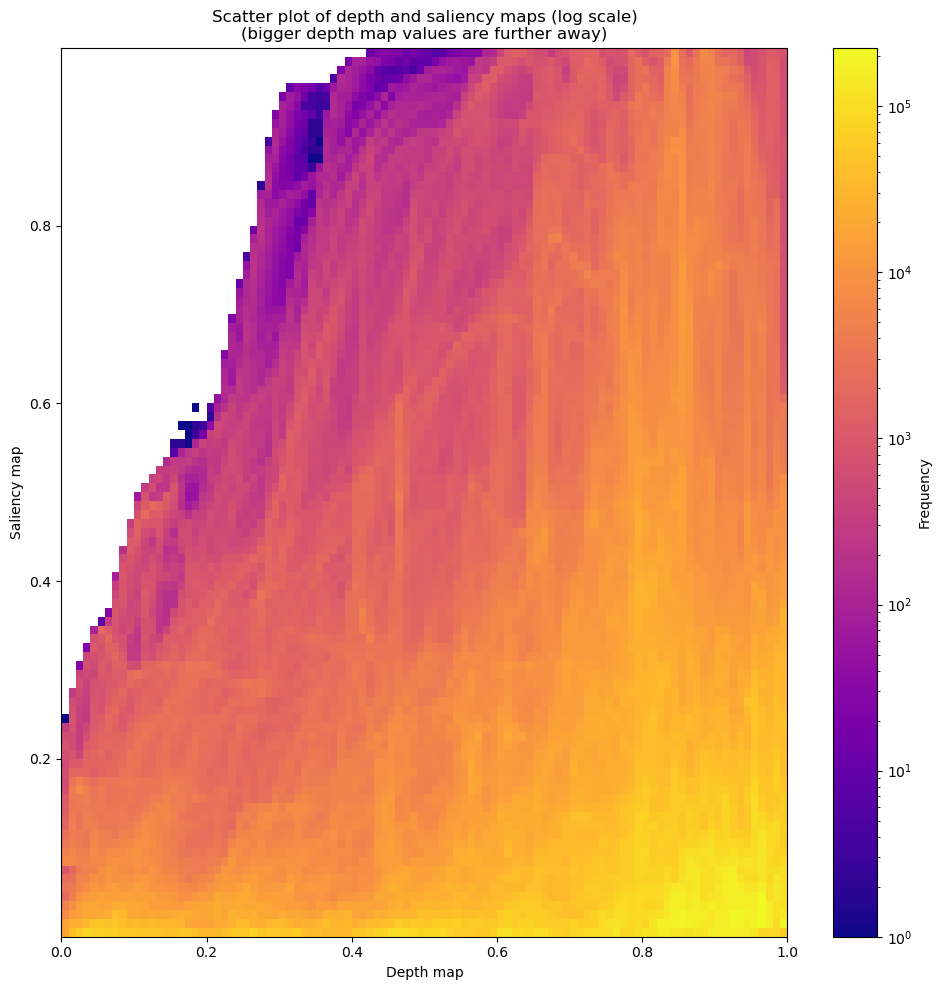

In [169]:
X_saliency = get_saliency_depth_features()

# Show plot as heatmap
plt.figure(figsize=(10, 10))
plt.hist2d(X_saliency[:, 0], X_saliency[:, 1], bins=N_BINS, cmap="plasma", norm=mcolors.LogNorm())
plt.xlabel("Depth map")
plt.ylabel("Saliency map")
plt.title(
    "Scatter plot of depth and saliency maps (log scale)\n(bigger depth map values are further away)"
)
plt.tight_layout()
plt.colorbar(label="Frequency")
plt.show()

⌛ Loading saliency maps...: 100%|██████████| 50/50 [00:00<00:00, 11658.62it/s]

Optimized parameters: x0=48.9818527389348, y0=65.70612893691576, sigma_x=22.68076307789968, sigma_y=22.782084085107744, A=0.0003211730900046171


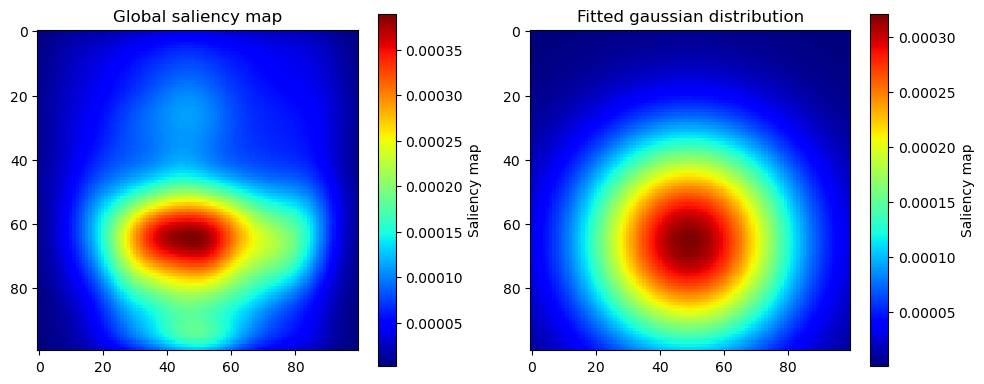

In [170]:
global_saliency_map = get_global_saliency_map()
fitted_gaussian = fit_gaussian(
    data=global_saliency_map,
    width=global_saliency_map.shape[1],
    height=global_saliency_map.shape[0],
)

plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(global_saliency_map, cmap="jet")
plt.colorbar(label="Saliency map")
plt.title("Global saliency map")
plt.subplot(1, 2, 2)
plt.imshow(fitted_gaussian, cmap="jet")
plt.colorbar(label="Saliency map")
plt.title("Fitted gaussian distribution")
plt.tight_layout()
plt.show()

⌛ Loading maps...: 50it [00:04, 10.82it/s]


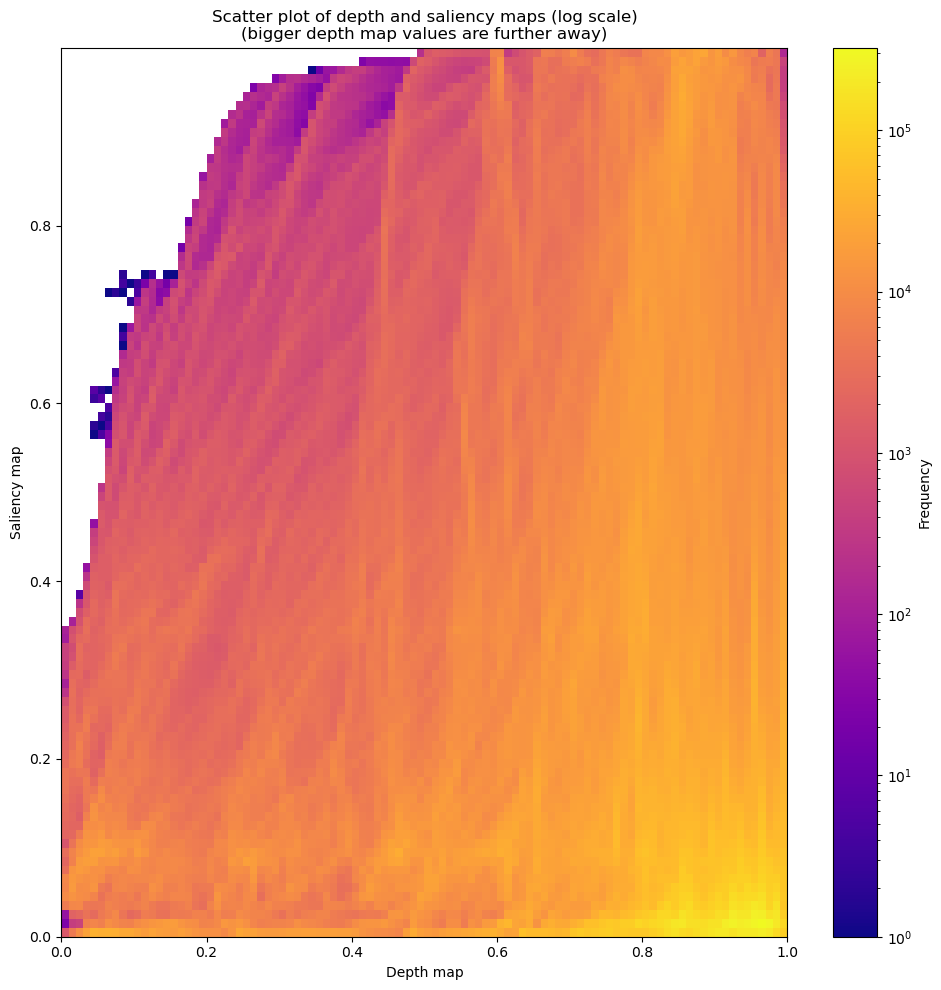

In [171]:
depth_file_paths = Path(DEPTH_MAP_PFM_PATH).rglob("*.pfm")
depth_file_paths = sorted(depth_file_paths)

center_bias_distribution = cv2.normalize(
    fitted_gaussian, None, 0, 1, cv2.NORM_MINMAX, cv2.CV_32F
)

X_center_bias = get_center_bias_depth_features(center_bias_distribution=center_bias_distribution)

# Show plot as heatmap
plt.figure(figsize=(10, 10))
plt.hist2d(X_center_bias[:, 0], X_center_bias[:, 1], bins=N_BINS, cmap="plasma", norm=mcolors.LogNorm())
plt.xlabel("Depth map")
plt.ylabel("Saliency map")
plt.title(
    "Scatter plot of depth and saliency maps (log scale)\n(bigger depth map values are further away)"
)
plt.tight_layout()
plt.colorbar(label="Frequency")
plt.show()

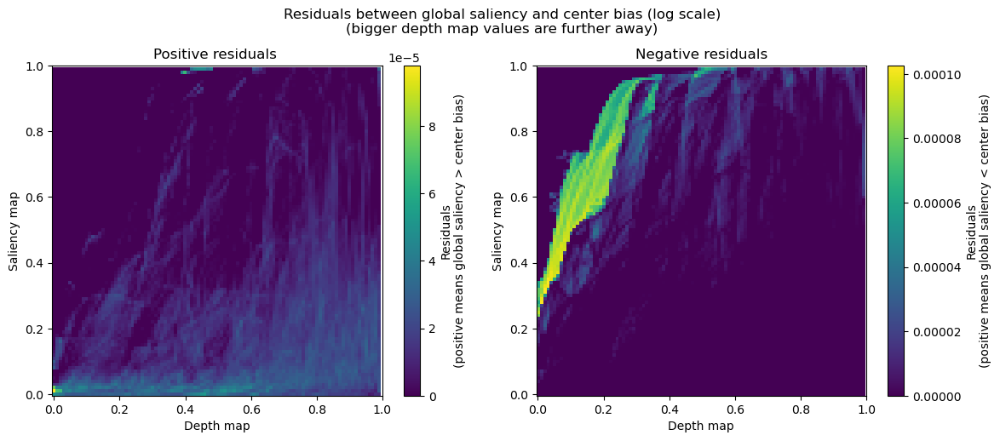

In [173]:
# Get residuals
hist_saliency = np.histogram2d(X_saliency[:, 0], X_saliency[:, 1], bins=N_BINS)[0].T
hist_saliency = np.log(hist_saliency + 1)
hist_saliency /= hist_saliency.sum()
hist_center_bias = np.histogram2d(X_center_bias[:, 0], X_center_bias[:, 1], bins=N_BINS)[0].T
hist_center_bias = np.log(hist_center_bias + 1)
hist_center_bias /= hist_center_bias.sum()

pos_diff = np.maximum(hist_saliency - hist_center_bias, 0)
neg_diff = np.maximum(hist_center_bias - hist_saliency, 0)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(pos_diff)
plt.xlabel("Depth map")
plt.ylabel("Saliency map")
plt.title("Positive residuals ")
plt.colorbar(label="Residuals\n(positive means global saliency > center bias)")
plt.gca().invert_yaxis()
plt.yticks(np.linspace(0, N_BINS, 6), np.round(np.linspace(0, 1, 6), 2))
plt.xticks(np.linspace(0, N_BINS, 6), np.round(np.linspace(0, 1, 6), 2))
plt.subplot(1, 2, 2)
plt.imshow(neg_diff)
plt.xlabel("Depth map")
plt.ylabel("Saliency map")
plt.title("Negative residuals")
plt.colorbar(label="Residuals\n(positive means global saliency < center bias)")
plt.gca().invert_yaxis()
plt.yticks(np.linspace(0, N_BINS, 6), np.round(np.linspace(0, 1, 6), 2))
plt.xticks(np.linspace(0, N_BINS, 6), np.round(np.linspace(0, 1, 6), 2))
plt.suptitle("Residuals between global saliency and center bias (log scale)\n(bigger depth map values are further away)")
plt.tight_layout()
plt.show()